In [52]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
import glob
import os

# Imports para 3D e Animação
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Configura o estilo dos gráficos
plt.style.use(['science', 'notebook', 'grid'])

# AUMENTA O LIMITE DE TAMANHO DA ANIMAÇÃO (EM MB)
plt.rcParams['animation.embed_limit'] = 25.0

In [53]:
def carregar_dados(pasta):
    """
    Lê todos os arquivos .dat da pasta especificada,
    extrai os parâmetros do nome do arquivo e
    armazena os dados da trajetória (t, x, y, z).
    """
    arquivos = glob.glob(os.path.join(pasta, '*.dat'))
    dados = {}
    
    for arq_path in arquivos:
        # Extrai o nome do arquivo, ex: "0.0005_1.20_ 0.15.dat"
        nome_arq = os.path.basename(arq_path)
        
        # Remove a extensão .dat
        nome_params = nome_arq.replace('.dat', '')
        
        # Separa os parâmetros
        partes = nome_params.split('_')
        
        try:
            beta = float(partes[0].strip())
            theta = float(partes[1].strip())
            phi = float(partes[2].strip())
            
            # Usa o nome do arquivo como chave
            # Carrega os dados usando o método especificado
            # Colunas: 0=t, 1=x, 2=y, 3=z
            array_dados = pd.read_csv(arq_path, sep='\s+', header=None).to_numpy().T
            
            dados[nome_arq] = {
                'beta': beta,
                'theta': theta,
                'phi': phi,
                'dados': array_dados
            }
            
        except (IndexError, ValueError) as e:
            print(f"Erro ao processar o arquivo {nome_arq}: {e}")
            
    return dados

def obter_label(params):
    """
    Cria uma string LaTeX formatada para a legenda do gráfico.
    """
    return (f"$\\beta_0/m_b = {params['beta']:.4f}$, "
            f"$\\theta_0 = {params['theta']:.2f}$, "
            f"$\\phi_0 = {params['phi']:.2f}$")

# Carrega todos os dados
pasta_dados = './graphics_out/'
dados_trajetoria = carregar_dados(pasta_dados)

# Imprime as chaves dos dados carregados para verificação
print("Arquivos carregados:")
for chave in dados_trajetoria.keys():
    print(f"- {chave}")

Arquivos carregados:
- 0.0005_1.20_ 0.15.dat
- 0.0001_1.20_ 0.15.dat
- 0.0005_1.20_-0.15.dat
- 0.0010_1.20_ 0.15.dat
- 0.0005_1.45_ 0.15.dat


<>:28: SyntaxWarning: invalid escape sequence '\s'
<>:28: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_33525/597300018.py:28: SyntaxWarning: invalid escape sequence '\s'
  array_dados = pd.read_csv(arq_path, sep='\s+', header=None).to_numpy().T


Gráfico 'grafA.pdf' salvo.


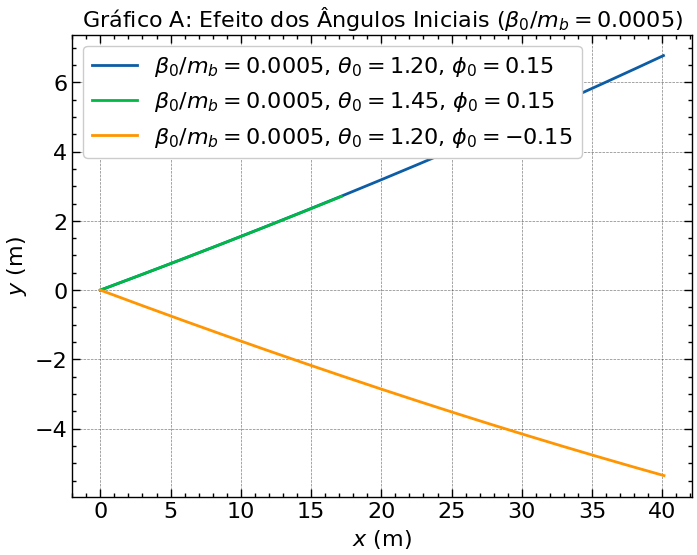

In [54]:
# Arquivos para o Gráfico A, conforme 'exercicio.f90'
# 1. beta=0.0005, theta=1.20, phi=0.15 [cite: 297]
# [cite_start]2. beta=0.0005, theta=1.45, phi=0.15 [cite: 297]
# [cite_start]3. beta=0.0005, theta=1.20, phi=-0.15 [cite: 297]
arquivos_grafA = [
    '0.0005_1.20_ 0.15.dat',
    '0.0005_1.45_ 0.15.dat',
    '0.0005_1.20_-0.15.dat'
]

plt.figure(figsize=(8, 6))

for nome_arq in arquivos_grafA:
    if nome_arq in dados_trajetoria:
        info = dados_trajetoria[nome_arq]
        dados = info['dados']
        
        # dados[1] -> x, dados[2] -> y
        plt.plot(dados[1], dados[2], label=obter_label(info))
    else:
        print(f"Aviso (Graf A): Arquivo {nome_arq} não encontrado.")

plt.title(r'Gráfico A: Efeito dos Ângulos Iniciais ($\beta_0/m_b = 0.0005$)')
plt.xlabel(r'$x$ (m)')
plt.ylabel(r'$y$ (m)')
plt.legend()
plt.savefig('grafA.pdf')
print("Gráfico 'grafA.pdf' salvo.")
plt.show()

Gráfico 'grafB.pdf' salvo.


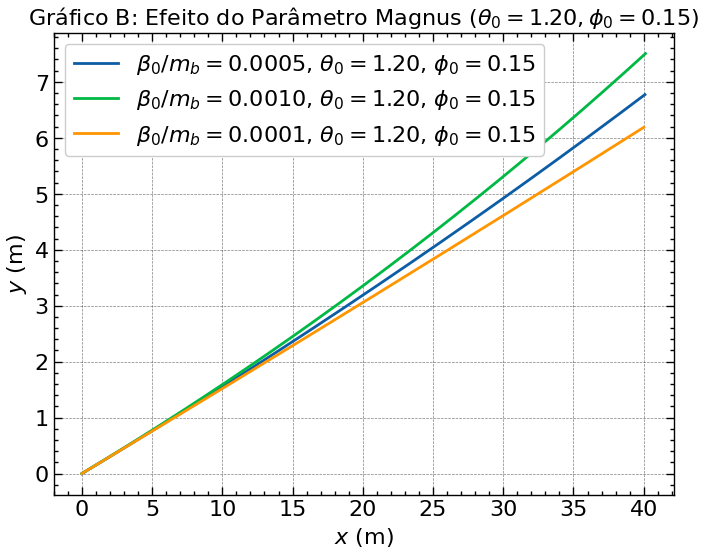

In [55]:
# Arquivos para o Gráfico B, conforme 'exercicio.f90'
# [cite_start]1. beta=0.0005, theta=1.20, phi=0.15 [cite: 298]
# [cite_start]2. beta=0.0010, theta=1.20, phi=0.15 [cite: 298]
# [cite_start]3. beta=0.0001, theta=1.20, phi=0.15 [cite: 298]
arquivos_grafB = [
    '0.0005_1.20_ 0.15.dat',
    '0.0010_1.20_ 0.15.dat',
    '0.0001_1.20_ 0.15.dat'
]

plt.figure(figsize=(8, 6))

for nome_arq in arquivos_grafB:
    if nome_arq in dados_trajetoria:
        info = dados_trajetoria[nome_arq]
        dados = info['dados']
        
        # dados[1] -> x, dados[2] -> y
        plt.plot(dados[1], dados[2], label=obter_label(info))
    else:
        print(f"Aviso (Graf B): Arquivo {nome_arq} não encontrado.")

plt.title(r'Gráfico B: Efeito do Parâmetro Magnus ($\theta_0=1.20, \phi_0=0.15$)')
plt.xlabel(r'$x$ (m)')
plt.ylabel(r'$y$ (m)')
plt.legend()
plt.savefig('grafB.pdf')
print("Gráfico 'grafB.pdf' salvo.")
plt.show()

Gráfico 'grafC.pdf' salvo.


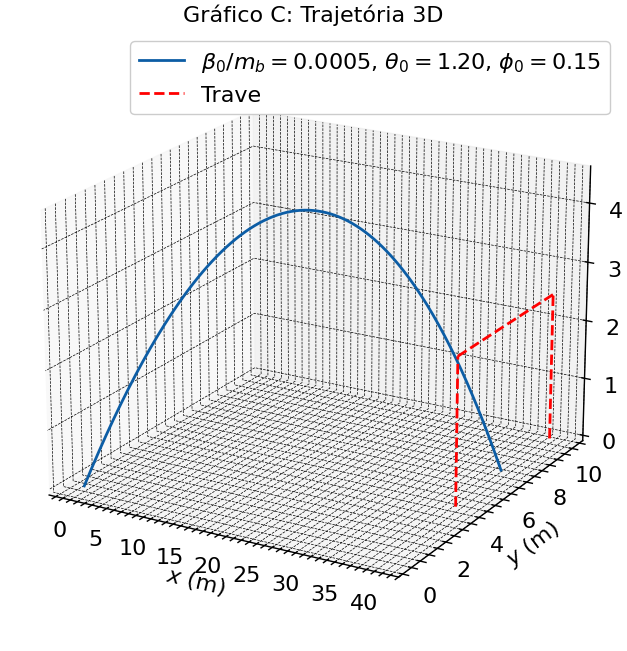

In [56]:
# Arquivo para o Gráfico C
nome_arq_C = '0.0005_1.20_ 0.15.dat'

if nome_arq_C in dados_trajetoria:
    info_c = dados_trajetoria[nome_arq_C]
    dados_c = info_c['dados']
    
    x, y, z = dados_c[1], dados_c[2], dados_c[3]
    
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plota a trajetória
    ax.plot(x, y, z, label=obter_label(info_c))
    
    # [cite_start]Plota o gol (conforme PDF) [cite: 169]
    # Vértices: (40, 4, 2.5) e (40, 10, 2.5)
    # Trave 1
    ax.plot([40, 40], [4, 4], [0, 2.5], color='red', linestyle='--', label='Trave')
    # Trave 2
    ax.plot([40, 40], [10, 10], [0, 2.5], color='red', linestyle='--')
    # Travessão
    ax.plot([40, 40], [4, 10], [2.5, 2.5], color='red', linestyle='--')
    
    ax.set_title(r'Gráfico C: Trajetória 3D')
    ax.set_xlabel(r'$x$ (m)')
    ax.set_ylabel(r'$y$ (m)')
    ax.set_zlabel(r'$z$ (m)')
    ax.legend()
    
    # Ajusta o ângulo de visão para melhor visualização
    ax.view_init(elev=20., azim=-60)
    
    plt.savefig('grafC.pdf')
    print("Gráfico 'grafC.pdf' salvo.")
    plt.show()

else:
    print(f"Aviso (Graf C): Arquivo {nome_arq_C} não encontrado.")

In [57]:
# Usaremos os mesmos dados do Gráfico C
if nome_arq_C in dados_trajetoria:
    info_anim = dados_trajetoria[nome_arq_C]
    dados_anim = info_anim['dados']
    
    # Usa os dados brutos diretamente, sem interpolação
    x_anim, y_anim, z_anim = dados_anim[1], dados_anim[2], dados_anim[3]

    # Configuração da figura
    fig_anim = plt.figure(figsize=(10, 8))
    ax_anim = fig_anim.add_subplot(111, projection='3d')
    
    # --- Correção dos Eixos (Mantida) ---
    
    # Coordenadas da trave (para definir os limites)
    goal_y_min, goal_y_max = 4.0, 10.0
    goal_z_min, goal_z_max = 0.0, 2.5
    
    # Define os limites dos eixos considerando BOLA e TRAVE
    # O limite X deve incluir o último ponto da bola (que passa de 40)
    ax_anim.set_xlim(0, np.max(x_anim) + 1)
    
    # Limite Y: deve incluir min(y_bola) e max(y_bola, y_trave)
    y_min_limit = min(np.min(y_anim), goal_y_min)
    y_max_limit = max(np.max(y_anim), goal_y_max)
    ax_anim.set_ylim(y_min_limit - 1, y_max_limit + 1) # Adiciona padding
    
    # Limite Z: deve incluir min(z_bola) e max(z_bola, z_trave)
    z_min_limit = min(np.min(z_anim), goal_z_min)
    z_max_limit = max(np.max(z_anim), goal_z_max)
    ax_anim.set_zlim(z_min_limit, z_max_limit + 1) # Adiciona padding (z_min é 0)
    
    # --- Fim da Correção dos Eixos ---

    # Define os labels
    ax_anim.set_title(r'Animação da Trajetória 3D')
    ax_anim.set_xlabel(r'$x$ (m)')
    ax_anim.set_ylabel(r'$y$ (m)')
    ax_anim.set_zlabel(r'$z$ (m)')

    # Plota o gol (estático)
    ax_anim.plot([40, 40], [4, 4], [0, 2.5], color='red', linestyle='--', label='Trave')
    ax_anim.plot([40, 40], [10, 10], [0, 2.5], color='red', linestyle='--')
    ax_anim.plot([40, 40], [4, 10], [2.5, 2.5], color='red', linestyle='--')
    ax_anim.legend()

    # Linha da trajetória e ponto da bola
    linha, = ax_anim.plot([], [], [], lw=2)
    bola, = ax_anim.plot([], [], [], 'o', color='red', markersize=8)
    
    # Função de inicialização
    def init():
        linha.set_data([], [])
        linha.set_3d_properties([])
        bola.set_data([], [])
        bola.set_3d_properties([])
        return linha, bola

    # Função de animação
    def animate(i):
        linha.set_data(x_anim[:i], y_anim[:i])
        linha.set_3d_properties(z_anim[:i])
        bola.set_data(x_anim[i:i+1], y_anim[i:i+1])
        bola.set_3d_properties(z_anim[i:i+1])
        return linha, bola

    # Cria a animação
    frames = np.arange(0, len(x_anim), 2)
    
    anim = FuncAnimation(
        fig_anim, 
        animate, 
        init_func=init, 
        frames=frames, 
        interval=20, 
        blit=True
    )

    # Fecha o plot estático para mostrar apenas a animação
    plt.close(fig_anim)

    # Salva a animação
    print("Salvando animação como 'animacaoC.mp4'...")
    anim.save('animacaoC.mp4', writer='ffmpeg', fps=30)
    print("...Salvo com sucesso!")

    # Exibe a animação no notebook
    print("Gerando animação para o notebook...")
    display(HTML(anim.to_jshtml()))

else:
    print(f"Aviso (Animação): Arquivo {nome_arq_C} não encontrado.")

Salvando animação como 'animacaoC.mp4'...
...Salvo com sucesso!
Gerando animação para o notebook...


Animation size has reached 26601896 bytes, exceeding the limit of 26214400.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
